<h3 style="text-align: center;">
Emory University - Department of Economics
</h3>

<h4 style="text-align: center;">
Prof. Maria Arbatskaya, Ph.D.
</h4>

<h5 style="text-align: center;">
Student: Fareed Wajid Khan 

Date: December 11th, 2023
</h5>

### Table of contents

0. Packages and some specific settings
1. Access Keepa API
2. Amazon categories
3. Product history query
4. Variation query
5. Top sellers query

### 0. Packages and some specific settings

In [2]:
pip install aiohttp

Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install tqdm

Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install keepa

Note: you may need to restart the kernel to use updated packages.


In [5]:
pip install asyncio

Note: you may need to restart the kernel to use updated packages.


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import aiohttp
import tqdm
import keepa
import os
import asyncio

#plt.style.use('whitegrid') # Matplotlib style
plt.rcParams['figure.figsize'] = [6, 3] # Matplotlib figure size

# Set working directory (change to your own)
path = "/Users/fareedkhan/Documents/Thesis"
os.chdir(path)

# Data Organization & Preprocessing

In [20]:
import pandas as pd

# Import Data
original_data = pd.read_csv("Keepa Vitamin D Sep23.csv")
modified_data = original_data.drop(['Locale', 'Image'], axis =1)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

#Parsing Sales rank
def parse_sales_rank(row):
    if isinstance(row, str):
        parts = row.split('|')
        absolute_rank = parts[0].strip()
        top_1_percent = parts[1].strip()

        category_part = parts[-1].strip()
        category = category_part.split(';')[0].strip()

        return pd.Series([absolute_rank, top_1_percent, category])
    else:
        return pd.Series([None,None,None])

#S Split Subcategory sales rank for processing
new_columns = original_data['Sales Rank: Subcategory Sales Ranks'].apply(parse_sales_rank)
new_columns.columns = ['Absolute Rank', 'Top 1 Percent', 'Category']
modified_data = pd.concat([modified_data, new_columns], axis=1)


# Rempve unnessesary data
modified_data = modified_data.drop(['Sales Rank: Subcategory Sales Ranks'], axis =1)
modified_data = modified_data.drop(['Sales Rank: Reference'], axis =1)
modified_data = modified_data.drop(['Top 1 Percent'], axis =1)

# Convert Absolute Rank into numeric
modified_data['Absolute Rank'] = modified_data['Absolute Rank'].str.strip('# ')
modified_data['Absolute Rank'] = pd.to_numeric(modified_data['Absolute Rank'],errors='coerce')

#Count Variation ASIN
modified_data['Variation ASINs'] = modified_data['Variation ASINs'].fillna("")
modified_data['Variation ASIN Count'] = modified_data['Variation ASINs'].apply(lambda x: len(x.split(',')))


#modified_data.head()
#modified_data.to_csv('Modified.csv')


print(modified_data['New: Current'])

## Data Prep (Converting Data & One-Hot Encoding)

In [21]:
import statsmodels

# Categorizing Data
categorical_column_data = ['Buy Box Seller', 'Buy Box Used Seller', 'Buy Box Used: Condition', 'Categories: Root', 'Categories: Sub', 'Categories: Tree', 'ASIN', 'Product Codes: EAN', 'Product Codes: UPC', 'Product Codes: PartNumber', 'Parent ASIN', 'Variation ASINs', 'Freq. Bought Together', 'Type', 'Manufacturer', 'Brand', 'Product Group', 'Model', 'Variation Attributes', 'Color', 'Size', 'Edition', 'Format', 'Author', 'Contributors', 'Binding', 'Languages', 'Hazardous Materials', 'Category']
numeric_column_data = ['Sales Rank: Current', 'Amazon: 90 days OOS', 'New: 90 days OOS', 'Used: 90 days OOS', 'Sales Rank: 90 days avg.', 'Sales Rank: Drops last 90 days', 'Bought in past month','Reviews: Review Count', 'Buy Box 🚚: Current', 'Buy Box 🚚: 90 days avg.', 'Buy Box 🚚: Stock', 'Amazon: Current', 'Amazon: 90 days avg.', 'New: Current', 'New: 90 days avg.','New, 3rd Party FBA: Current','New: 90 days avg.','New, 3rd Party FBA: 90 days avg.', 'FBA Pick&Pack Fee', 'Referral Fee based on current Buy Box price', 'New, 3rd Party FBA: Current', 'New, 3rd Party FBA: 90 days avg.', 'New, Prime exclusive: Current', 'New, Prime exclusive: 90 days avg.', 'Lightning Deals: Current', 'Buy Box Used 🚚: Current', 'Buy Box Used 🚚: 90 days avg.', 'Used: Current', 'Used: 90 days avg.', 'Used, like new 🚚: Current', 'Used, like new 🚚: 90 days avg.', 'Used, very good 🚚: Current', 'Used, very good 🚚: 90 days avg.', 'Used, good 🚚: Current', 'Used, good 🚚: 90 days avg.', 'Used, acceptable 🚚: Current', 'Used, acceptable 🚚: 90 days avg.', 'Warehouse Deals: Current', 'Warehouse Deals: 90 days avg.', 'List Price: Current', 'List Price: 90 days avg.', 'Rental: Current', 'Rental: 90 days avg.', 'eBay New 🚚: Current', 'eBay New 🚚: 90 days avg.', 'eBay Used 🚚: Current', 'eBay Used 🚚: 90 days avg.', 'New Offer Count: Current', 'New Offer Count: 90 days avg.', 'Count of retrieved live offers: New, FBM', 'Used Offer Count: Current', 'Used Offer Count: 90 days avg.', 'Number of Items', 'Number of Pages', 'Package: Dimension (cm³)', 'Package: Weight (g)', 'Package: Quantity', 'Item: Dimension (cm³)', 'Item: Weight (g)', 'One Time Coupon: Absolute', 'One Time Coupon: Percentage', 'Absolute Rank', 'Variation ASIN Count']
binary_column_data = ['Buy Box: Is FBA', 'Buy Box: Unqualified', 'Lightning Deals: Upcoming Deal', 'Buy Box Used: Is FBA', 'Categories: Launchpad', 'Adult Product', 'Trade-In Eligible', 'Prime Eligible (Buy Box)', 'Subscribe and Save']

# Fill NA categorical data
for column in categorical_column_data:
    modified_data[column] = modified_data[column].fillna('Missing') 

# Encode categorical data (one hot encoding // high dimensionality)
df_categorical_encoded = pd.get_dummies(modified_data, columns=categorical_column_data, dtype=int)

#Convert from float to numeric for numeric data
for column in numeric_column_data:
    df_categorical_encoded[column] = pd.to_numeric(df_categorical_encoded[column], errors='coerce')
    # Correctly assign the result of fillna back to the DataFrame
    df_categorical_encoded[column] = df_categorical_encoded[column].fillna(0)
#Encoding binary data in column to 1/0
for column in binary_column_data:
    df_categorical_encoded[column] = df_categorical_encoded[column].map(lambda x: 1 if x == 'yes' else 0)

#Encode Rating data
df_categorical_encoded['Reviews: Rating'] = pd.to_numeric(df_categorical_encoded['Reviews: Rating'], errors='coerce')

# Convert % data into numeric
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'].str.replace('%', '').astype(float)
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'].fillna(0)
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'] /100

# Convert % data into numeric
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = df_categorical_encoded['Subscribe and Save Coupon: Percentage'].str.replace('%', '', regex=False)
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = pd.to_numeric(df_categorical_encoded['Subscribe and Save Coupon: Percentage'], errors='coerce')
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = df_categorical_encoded['Subscribe and Save Coupon: Percentage']/100
df_categorical_encoded['Subscribe and Save Coupon: Percentage']= df_categorical_encoded['Subscribe and Save Coupon: Percentage'].fillna(0)

# Convert % data into numeric
df_categorical_encoded['Buy Box 🚚: 90 days OOS'] = df_categorical_encoded['Buy Box 🚚: 90 days OOS'].str.replace('%', '', regex=False)
df_categorical_encoded['Buy Box 🚚: 90 days OOS'] = pd.to_numeric(df_categorical_encoded['Buy Box 🚚: 90 days OOS'], errors='coerce')
df_categorical_encoded['Buy Box 🚚: 90 days OOS']= df_categorical_encoded['Buy Box 🚚: 90 days OOS'].fillna(0)

# Encode Time Data
time_column_data = ['Last Price Change', 'Tracking since', 'Listed since', 'Publication Date', 'Release Date']
for column in time_column_data:
    df_categorical_encoded = df_categorical_encoded.drop(column, axis=1)

 
# Remove '$' signs from data
for column in df_categorical_encoded.columns:
    if df_categorical_encoded[column].dtype == object:
        if df_categorical_encoded[column].str.contains('\$', na=False).any():
            print(f"Column '{column}' contains a '$'")
            df_categorical_encoded[column] = df_categorical_encoded[column].str.replace('\$', '', regex=True)



final_data = df_categorical_encoded

Column 'New, 3rd Party FBM 🚚: Current' contains a '$'
Column 'New, 3rd Party FBM 🚚: 90 days avg.' contains a '$'


### Fill NA Values w/ Mean averages

In [22]:
#Check for Final null data
for column in final_data:
    if final_data[column].isnull().any():
        print(column)


Reviews: Rating
Ratings - Format Specific
Review Count - Format Specific
New, 3rd Party FBM 🚚: Current
New, 3rd Party FBM 🚚: 90 days avg.
Count of retrieved live offers: New, FBA


In [23]:
columns_to_fill = [
    'Sales Rank: 90 days avg.', 'Sales Rank: Drops last 90 days', 'Bought in past month',
    'Reviews: Rating', 'Reviews: Review Count', 'Ratings - Format Specific',
    'Review Count - Format Specific', 'Buy Box 🚚: Current', 'Buy Box 🚚: 90 days avg.', 'Buy Box 🚚: Stock', 
    'Amazon: Current', 'Amazon: 90 days avg.', 'Amazon: 90 days OOS', 'New: 90 days avg.', 'New: 90 days OOS', 'New, 3rd Party FBA: Current',
    'New, 3rd Party FBA: 90 days avg.', 'FBA Pick&Pack Fee', 'Referral Fee based on current Buy Box price',
    'New, 3rd Party FBM 🚚: Current', 'New, 3rd Party FBM 🚚: 90 days avg.', 'New, Prime exclusive: Current',
    'New, Prime exclusive: 90 days avg.', 'Lightning Deals: Current', 'Buy Box Used 🚚: Current', 'Buy Box Used 🚚: 90 days avg.', 'Used: Current', 'Used: 90 days avg.', 'Used: 90 days OOS',
    'Used, like new 🚚: Current', 'Used, like new 🚚: 90 days avg.', 'Used, very good 🚚: Current',
    'Used, very good 🚚: 90 days avg.', 'Used, good 🚚: Current', 'Used, good 🚚: 90 days avg.',
    'Used, acceptable 🚚: Current', 'Used, acceptable 🚚: 90 days avg.', 'Warehouse Deals: Current',
    'Warehouse Deals: 90 days avg.', 'List Price: Current', 'List Price: 90 days avg.',
    'Rental: Current', 'Rental: 90 days avg.', 'eBay New 🚚: Current', 'eBay New 🚚: 90 days avg.',
    'eBay Used 🚚: Current', 'eBay Used 🚚: 90 days avg.', 'New Offer Count: Current',
    'Count of retrieved live offers: New, FBA', 'Count of retrieved live offers: New, FBM',
    'Used Offer Count: Current', 'Used Offer Count: 90 days avg.', 'Number of Items',
    'Number of Pages', 'Package: Dimension (cm³)', 'Package: Weight (g)', 'Package: Quantity',
    'Item: Dimension (cm³)', 'Item: Weight (g)', 'One Time Coupon: Absolute',
    'One Time Coupon: Percentage', 'Absolute Rank'
]

# for column in columns_to_fill:
#     if column in final_data.columns:
#         if final_data[column].dtype == object:
#             print(column)
for column in columns_to_fill:
    if column in final_data.columns:
        final_data[column] = pd.to_numeric(final_data[column], errors='coerce')
        column_mean = final_data[column].mean()
        final_data[column] = final_data[column].fillna(0)
    else:
        print(f"{column} not found in DataFrame.")

In [232]:
print(final_data['New: Current'])

0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
5       0.0
6       0.0
7       0.0
8       0.0
9       0.0
10      0.0
11      0.0
12      0.0
13      0.0
14      0.0
15      0.0
16      0.0
17      0.0
18      0.0
19      0.0
20      0.0
21      0.0
22      0.0
23      0.0
24      0.0
25      0.0
26      0.0
27      0.0
28      0.0
29      0.0
30      0.0
31      0.0
32      0.0
33      0.0
34      0.0
35      0.0
36      0.0
37      0.0
38      0.0
39      0.0
40      0.0
41      0.0
42      0.0
43      0.0
44      0.0
45      0.0
46      0.0
47      0.0
48      0.0
49      0.0
50      0.0
51      0.0
52      0.0
53      0.0
54      0.0
55      0.0
56      0.0
57      0.0
58      0.0
59      0.0
60      0.0
61      0.0
62      0.0
63      0.0
64      0.0
65      0.0
66      0.0
67      0.0
68      0.0
69      0.0
70      0.0
71      0.0
72      0.0
73      0.0
74      0.0
75      0.0
76      0.0
77      0.0
78      0.0
79      0.0
80      0.0
81      0.0
82      0.0
83  

## Splitting and Training

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error


modified_data_testing = final_data.drop(['Title'], axis = 1)
# Dropping title

# Splitting Data
X = modified_data_testing.drop('Sales Rank: Current', axis=1)  # Features
y = modified_data_testing['Sales Rank: Current']  # Target variable
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

from sklearn.impute import SimpleImputer
X_train.replace([np.inf, -np.inf], np.nan, inplace=True)
imputer = SimpleImputer(strategy='mean')  # or median, most_frequent, constant
X_train_imputed = imputer.fit_transform(X_train)
y_train_imputed = y_train  # Assuming y_train does not contain NaN values; otherwise, apply imputation as well
# Replace inf with NaN and then impute or remove

# Train Model
model = LinearRegression()
model.fit(X_train_imputed, y_train_imputed)
predictions = model.predict(X_test)

# MSE Error
mse = mean_squared_error(y_test, predictions)
print(f"Mean Squared Error: {mse}")

## Scatter Plot - OLS

import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(8, 6))
plt.scatter(y_test, predictions, alpha=0.5)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Actual vs. Predicted Values')
plt.show()


## Residual Plot - OLS

residuals = y_test - predictions

plt.figure(figsize=(8, 6))
sns.residplot(x=predictions, y=residuals, lowess=True, line_kws={'color': 'red', 'lw': 1})
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residual Plot')
plt.axhline(y=0, color='black', linestyle='--')
plt.show()


## Coefficient Plot - OLS

do not run this

feature_names = X_train.columns
coefficients = model.coef_

# Create a DataFrame for easier plotting
coef_df = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})
# Sort the DataFrame by the absolute value of the coefficients
coef_df = coef_df.sort_values(by='Coefficient', key=abs, ascending=False)

# Plotting
plt.figure(figsize=(10, 8))
sns.barplot(x='Coefficient', y='Feature', data=coef_df)
plt.title('Feature Coefficients')
plt.xlabel('Coefficient Value')
plt.ylabel('Features')
plt.show()


# Lasso

from sklearn.linear_model import Lasso

lasso_model = Lasso(alpha=0.01)  

lasso_model.fit(X_train, y_train)

Lasso Predictions

# Making predictions
predictions_lasso = lasso_model.predict(X_test)

# Calculating the Mean Squared Error (MSE)
mse_lasso = mean_squared_error(y_test, predictions_lasso)
print(f"Mean Squared Error for Lasso Regression: {mse_lasso}")


Cross Validation for Lasso Alpha value

from sklearn.linear_model import LassoCV

# Initialize and fit the LassoCV to find the best alpha
lasso_cv_model = LassoCV(alphas=None, cv=10, max_iter=10000)
lasso_cv_model.fit(X_train, y_train)

# Best alpha
print("Best alpha using LassoCV: ", lasso_cv_model.alpha_)

# You can now initialize a new Lasso model with this best alpha
lasso_model_optimal = Lasso(alpha=lasso_cv_model.alpha_)
lasso_model_optimal.fit(X_train, y_train)


Lasso w/ Best Alpha

lasso_model_best = Lasso(alpha=13545.149148283259)  

lasso_model_best.fit(X_train, y_train)

predictions_lasso_best = lasso_model_best.predict(X_test)

# Calculating the Mean Squared Error (MSE)
mse_lasso_best = mean_squared_error(y_test, predictions_lasso_best)
print(f"Mean Squared Error for Lasso Regression: {mse_lasso_best}")


In [123]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split

modified_data_testing = final_data.drop(['Title'], axis = 1)

# Log transformation of 'Sales Rank: Current'
modified_data_testing['Log Sales Rank: Current'] = np.log(modified_data_testing['Sales Rank: Current'])

# Define the columns of interest for the features (excluding 'Variation ASIN Count' as it was not found)
columns_of_interest = ['Reviews: Rating', 'Reviews: Review Count', 'Buy Box: Is FBA', 
                       'Variation ASIN Count', 'FBA Pick&Pack Fee', 'New Offer Count: Current', 'New: Current']

# Drop rows with any NaN values in the specified features or target variable
cleaned_data = modified_data_testing[columns_of_interest + ['Log Sales Rank: Current']].dropna()

# Splitting the cleaned data into features (X) and target (y)
X2 = cleaned_data[columns_of_interest]
y2 = cleaned_data['Log Sales Rank: Current']

# Splitting the data into training and testing sets
X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y2, test_size=0.4, random_state=42)


/opt/anaconda3/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
<ipython-input-123-025f2b1fd22e>:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  modified_data_testing['Log Sales Rank: Current'] = np.log(modified_data_testing['Sales Rank: Current'])


In [127]:
y_test2.replace([np.inf, -np.inf], np.nan, inplace=True)
y_test2.fillna(y_test2.mean(), inplace=True)
# Assuming y_train_newDec is a Series; if it has potential infinity values:
y_train2.replace([np.inf, -np.inf], np.nan, inplace=True)
y_train2.fillna(y_train2.mean(), inplace=True)

In [128]:
# Check for NaNs again
print(X_test2.isnull().sum().sum(), "NaNs in X_train_newDec")
print(y_test2.isnull().sum(), "NaNs in y_train_newDec")

# Check for infinity
print(np.isinf(X_test2.values).sum(), "Infinities in X_train_newDec")
print(np.isinf(y_test2.values).sum(), "Infinities in y_test_newDec")

0 NaNs in X_train_newDec
0 NaNs in y_train_newDec
0 Infinities in X_train_newDec
0 Infinities in y_test_newDec


In [129]:
from sklearn.linear_model import LinearRegression
# Initializing and training the linear regression model
model = LinearRegression()
model.fit(X_train2, y_train2)

# Making predictions on the test set
predictions2 = model.predict(X_test2)


In [130]:
from sklearn.metrics import mean_squared_error
# Calculating the Mean Squared Error (MSE) for model evaluation
mse = mean_squared_error(y_test2, predictions2)
print(f"Mean Squared Error: {mse}")


Mean Squared Error: 0.9531180860533788


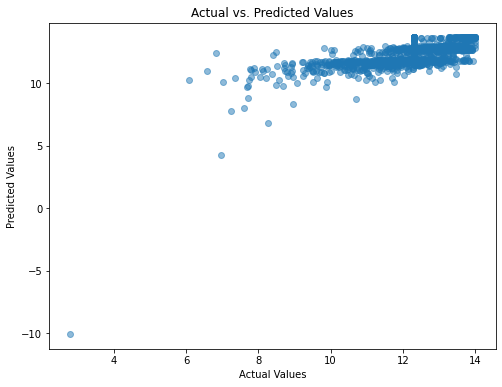

In [131]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(8, 6))
plt.scatter(y_test2, predictions2, alpha=0.5)
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Actual vs. Predicted Values')
plt.show()

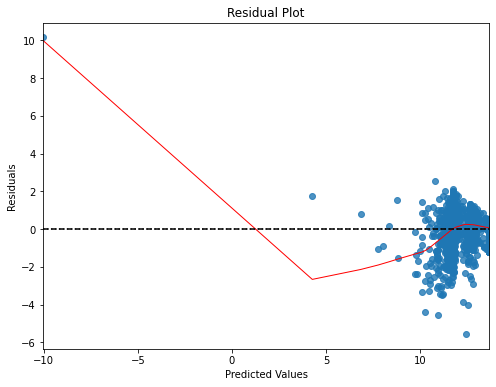

In [132]:
residuals2 = y_test2 - predictions2

plt.figure(figsize=(8, 6))
sns.residplot(x=predictions2, y=residuals2, lowess=True, line_kws={'color': 'red', 'lw': 1})
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residual Plot')
plt.axhline(y=0, color='black', linestyle='--')
plt.show()

In [22]:
pip install --upgrade numpy

Note: you may need to restart the kernel to use updated packages.


In [23]:
pip install --upgrade statsmodels

  Using cached numpy-1.22.4-cp38-cp38-macosx_10_15_x86_64.whl (17.6 MB)
  Attempting uninstall: numpy
    Found existing installation: numpy 1.24.4
    Uninstalling numpy-1.24.4:
      Successfully uninstalled numpy-1.24.4
Note: you may need to restart the kernel to use updated packages.


In [36]:
import statsmodels.api as sm
import numpy as np

# Add a constant to the features for the intercept
X_train_sm = sm.add_constant(X_train2)

# Fit the model
model = sm.OLS(y_train2, X_train_sm).fit()

# Print the summary
print(model.summary())


                               OLS Regression Results                              
Dep. Variable:     Log Sales Rank: Current   R-squared:                       0.510
Model:                                 OLS   Adj. R-squared:                  0.509
Method:                      Least Squares   F-statistic:                     571.7
Date:                     Wed, 21 Feb 2024   Prob (F-statistic):               0.00
Time:                             16:13:09   Log-Likelihood:                -3692.8
No. Observations:                     2750   AIC:                             7398.
Df Residuals:                         2744   BIC:                             7433.
Df Model:                                5                                         
Covariance Type:                 nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1966: RuntimeWarning: divide by zero encountered in double_scalars
  return np.sqrt(eigvals[0]/eigvals[-1])


In [37]:
from sklearn.linear_model import RidgeCV
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline

# Assuming X_train, y_train are already defined

# Create a RidgeCV model with multiple alpha values to choose from
alphas = [0.1, 1.0, 10.0, 100.0]  # Example alpha values
ridge_cv_model = make_pipeline(StandardScaler(), RidgeCV(alphas=alphas, store_cv_values=True))

# Fit the model
ridge_cv_model.fit(X_train2, y_train2)

# Optimal alpha value
optimal_alpha = ridge_cv_model.named_steps['ridgecv'].alpha_
print(f"Optimal alpha value: {optimal_alpha}")

# Predict and evaluate
predictions = ridge_cv_model.predict(X_test2)
mse = mean_squared_error(y_test2, predictions2)
print(f"Mean Squared Error with optimal alpha: {mse}")

Optimal alpha value: 100.0
Mean Squared Error with optimal alpha: 1.2203101526173425


In [38]:
import pandas as pd
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

# Assuming 'X' is already defined from your previous code
X = modified_data_testing[['Reviews: Rating', 'Reviews: Review Count', 'Buy Box: Is FBA', 
                            "Bought in past month", 'FBA Pick&Pack Fee', 'New Offer Count: Current', 'Variation ASIN Count']]

# It's important to add a constant term for the intercept for VIF calculation
X_with_constant = add_constant(X)

# Calculate VIF for each feature
vif_data = pd.DataFrame()
vif_data["Feature"] = X_with_constant.columns
vif_data["VIF"] = [variance_inflation_factor(X_with_constant.values, i) for i in range(X_with_constant.shape[1])]

print(vif_data)

                    Feature       VIF
0                     const  8.428577
1           Reviews: Rating  1.055116
2     Reviews: Review Count  3.351043
3           Buy Box: Is FBA  1.101893
4      Bought in past month  3.242459
5         FBA Pick&Pack Fee       NaN
6  New Offer Count: Current  1.100997
7      Variation ASIN Count  1.192959


/opt/anaconda3/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1782: RuntimeWarning: invalid value encountered in double_scalars
  return 1 - self.ssr/self.centered_tss


In [42]:
# Assuming 'final_data' is your current dataset
current_asins = set(modified_data['ASIN'])  # This creates a set of unique ASINs from your current dataset

In [43]:
# Load your new dataset
new_data = pd.read_csv('Keepa Vitamin D Feb24.csv')  # Adjust the path as necessary

# Filter the new dataset to only include ASINs that are in both datasets
filtered_new_dataFeb = new_data[new_data['ASIN'].isin(current_asins)]


In [44]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

#Parsing Sales rank
def parse_sales_rank(row):
    if isinstance(row, str):
        parts = row.split('|')
        absolute_rank = parts[0].strip()
        top_1_percent = parts[1].strip()

        category_part = parts[-1].strip()
        category = category_part.split(';')[0].strip()

        return pd.Series([absolute_rank, top_1_percent, category])
    else:
        return pd.Series([None,None,None])

#S Split Subcategory sales rank for processing
new_columnsFeb = new_data['Sales Rank: Subcategory Sales Ranks'].apply(parse_sales_rank)
new_columnsFeb.columns = ['Absolute Rank', 'Top 1 Percent', 'Category']
filtered_new_dataFeb = pd.concat([filtered_new_dataFeb, new_columns], axis=1)


# Rempve unnessesary data
filtered_new_dataFeb = filtered_new_dataFeb.drop(['Sales Rank: Subcategory Sales Ranks'], axis =1)
filtered_new_dataFeb = filtered_new_dataFeb.drop(['Sales Rank: Reference'], axis =1)
filtered_new_dataFeb = filtered_new_dataFeb.drop(['Top 1 Percent'], axis =1)

# Convert Absolute Rank into numeric
filtered_new_dataFeb['Absolute Rank'] = filtered_new_dataFeb['Absolute Rank'].str.strip('# ')
filtered_new_dataFeb['Absolute Rank'] = pd.to_numeric(filtered_new_dataFeb['Absolute Rank'],errors='coerce')

#Count Variation ASIN
filtered_new_dataFeb['Variation ASINs'] = filtered_new_dataFeb['Variation ASINs'].fillna("")
filtered_new_dataFeb['Variation ASIN Count'] = filtered_new_dataFeb['Variation ASINs'].apply(lambda x: len(x.split(',')))

In [45]:
import statsmodels

# Categorizing Data
categorical_column_data = ['Buy Box Seller', 'Buy Box Used Seller', 'Buy Box Used: Condition', 'Categories: Root', 'Categories: Sub', 'Categories: Tree', 'ASIN', 'Product Codes: EAN', 'Product Codes: UPC', 'Product Codes: PartNumber', 'Parent ASIN', 'Variation ASINs', 'Freq. Bought Together', 'Type', 'Manufacturer', 'Brand', 'Product Group', 'Model', 'Variation Attributes', 'Color', 'Size', 'Edition', 'Format', 'Author', 'Contributors', 'Binding', 'Languages', 'Hazardous Materials', 'Category']
numeric_column_data = ['Sales Rank: Current', 'Amazon: 90 days OOS', 'New: 90 days OOS', 'Used: 90 days OOS', 'Sales Rank: 90 days avg.', 'Sales Rank: Drops last 90 days', 'Bought in past month','Reviews: Review Count', 'Buy Box 🚚: Current', 'Buy Box 🚚: 90 days avg.', 'Buy Box 🚚: Stock', 'Amazon: Current', 'Amazon: 90 days avg.', 'New: Current', 'New: 90 days avg.','New, 3rd Party FBA: Current','New: 90 days avg.','New, 3rd Party FBA: 90 days avg.', 'FBA Pick&Pack Fee', 'Referral Fee based on current Buy Box price', 'New, 3rd Party FBA: Current', 'New, 3rd Party FBA: 90 days avg.', 'New, Prime exclusive: Current', 'New, Prime exclusive: 90 days avg.', 'Lightning Deals: Current', 'Buy Box Used 🚚: Current', 'Buy Box Used 🚚: 90 days avg.', 'Used: Current', 'Used: 90 days avg.', 'Used, like new 🚚: Current', 'Used, like new 🚚: 90 days avg.', 'Used, very good 🚚: Current', 'Used, very good 🚚: 90 days avg.', 'Used, good 🚚: Current', 'Used, good 🚚: 90 days avg.', 'Used, acceptable 🚚: Current', 'Used, acceptable 🚚: 90 days avg.', 'Warehouse Deals: Current', 'Warehouse Deals: 90 days avg.', 'List Price: Current', 'List Price: 90 days avg.', 'Rental: Current', 'Rental: 90 days avg.', 'eBay New 🚚: Current', 'eBay New 🚚: 90 days avg.', 'eBay Used 🚚: Current', 'eBay Used 🚚: 90 days avg.', 'New Offer Count: Current', 'New Offer Count: 90 days avg.', 'Count of retrieved live offers: New, FBM', 'Used Offer Count: Current', 'Used Offer Count: 90 days avg.', 'Number of Items', 'Number of Pages', 'Package: Dimension (cm³)', 'Package: Weight (g)', 'Package: Quantity', 'Item: Dimension (cm³)', 'Item: Weight (g)', 'One Time Coupon: Absolute', 'One Time Coupon: Percentage', 'Absolute Rank', 'Variation ASIN Count']
binary_column_data = ['Buy Box: Is FBA', 'Buy Box: Unqualified', 'Lightning Deals: Upcoming Deal', 'Buy Box Used: Is FBA', 'Categories: Launchpad', 'Adult Product', 'Trade-In Eligible', 'Prime Eligible (Buy Box)', 'Subscribe and Save']

# Fill NA categorical data
for column in categorical_column_data:
    filtered_new_dataFeb[column] = filtered_new_dataFeb[column].fillna('Missing') 

# Encode categorical data (one hot encoding // high dimensionality)
df_categorical_encoded = pd.get_dummies(filtered_new_dataFeb, columns=categorical_column_data, dtype=int)

#Convert from float to numeric for numeric data
for column in numeric_column_data:
    df_categorical_encoded[column] = pd.to_numeric(df_categorical_encoded[column], errors='coerce') 
    df_categorical_encoded[column].fillna(0)

#Encoding binary data in column to 1/0
for column in binary_column_data:
    df_categorical_encoded[column] = df_categorical_encoded[column].map(lambda x: 1 if x == 'yes' else 0)

#Encode Rating data
df_categorical_encoded['Reviews: Rating'] = pd.to_numeric(df_categorical_encoded['Reviews: Rating'], errors='coerce')

# Convert % data into numeric
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'].str.replace('%', '').astype(float)
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'].fillna(0)
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'] /100

# Convert % data into numeric
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = df_categorical_encoded['Subscribe and Save Coupon: Percentage'].str.replace('%', '', regex=False)
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = pd.to_numeric(df_categorical_encoded['Subscribe and Save Coupon: Percentage'], errors='coerce')
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = df_categorical_encoded['Subscribe and Save Coupon: Percentage']/100
df_categorical_encoded['Subscribe and Save Coupon: Percentage']= df_categorical_encoded['Subscribe and Save Coupon: Percentage'].fillna(0)

# Convert % data into numeric
df_categorical_encoded['Buy Box 🚚: 90 days OOS'] = df_categorical_encoded['Buy Box 🚚: 90 days OOS'].str.replace('%', '', regex=False)
df_categorical_encoded['Buy Box 🚚: 90 days OOS'] = pd.to_numeric(df_categorical_encoded['Buy Box 🚚: 90 days OOS'], errors='coerce')
df_categorical_encoded['Buy Box 🚚: 90 days OOS']= df_categorical_encoded['Buy Box 🚚: 90 days OOS'].fillna(0)

# Encode Time Data
time_column_data = ['Last Price Change', 'Tracking since', 'Listed since', 'Publication Date', 'Release Date']
for column in time_column_data:
    df_categorical_encoded = df_categorical_encoded.drop(column, axis=1)

 
# Remove '$' signs from data
for column in df_categorical_encoded.columns:
    if df_categorical_encoded[column].dtype == object:
        if df_categorical_encoded[column].str.contains('\$', na=False).any():
            print(f"Column '{column}' contains a '$'")
            df_categorical_encoded[column] = df_categorical_encoded[column].str.replace('\$', '', regex=True)



final_dataFeb = df_categorical_encoded

Column 'New, 3rd Party FBM 🚚: Current' contains a '$'
Column 'New, 3rd Party FBM 🚚: 90 days avg.' contains a '$'


In [46]:
columns_to_fill = [
    'Sales Rank: 90 days avg.', 'Sales Rank: Drops last 90 days', 'Bought in past month',
    'Reviews: Rating', 'Reviews: Review Count', 'Ratings - Format Specific',
    'Review Count - Format Specific', 'Buy Box 🚚: Current', 'Buy Box 🚚: 90 days avg.', 'Buy Box 🚚: Stock', 
    'Amazon: Current', 'Amazon: 90 days avg.', 'Amazon: 90 days OOS',
    'New: Current', 'New: 90 days avg.', 'New: 90 days OOS', 'New, 3rd Party FBA: Current',
    'New, 3rd Party FBA: 90 days avg.', 'FBA Pick&Pack Fee', 'Referral Fee based on current Buy Box price',
    'New, 3rd Party FBM 🚚: Current', 'New, 3rd Party FBM 🚚: 90 days avg.', 'New, Prime exclusive: Current',
    'New, Prime exclusive: 90 days avg.', 'Lightning Deals: Current', 'Buy Box Used 🚚: Current', 'Buy Box Used 🚚: 90 days avg.', 'Used: Current', 'Used: 90 days avg.', 'Used: 90 days OOS',
    'Used, like new 🚚: Current', 'Used, like new 🚚: 90 days avg.', 'Used, very good 🚚: Current',
    'Used, very good 🚚: 90 days avg.', 'Used, good 🚚: Current', 'Used, good 🚚: 90 days avg.',
    'Used, acceptable 🚚: Current', 'Used, acceptable 🚚: 90 days avg.', 'Warehouse Deals: Current',
    'Warehouse Deals: 90 days avg.', 'List Price: Current', 'List Price: 90 days avg.',
    'Rental: Current', 'Rental: 90 days avg.', 'eBay New 🚚: Current', 'eBay New 🚚: 90 days avg.',
    'eBay Used 🚚: Current', 'eBay Used 🚚: 90 days avg.', 'New Offer Count: Current',
    'Count of retrieved live offers: New, FBA', 'Count of retrieved live offers: New, FBM',
    'Used Offer Count: Current', 'Used Offer Count: 90 days avg.', 'Number of Items',
    'Number of Pages', 'Package: Dimension (cm³)', 'Package: Weight (g)', 'Package: Quantity',
    'Item: Dimension (cm³)', 'Item: Weight (g)', 'One Time Coupon: Absolute',
    'One Time Coupon: Percentage', 'Absolute Rank'
]

# for column in columns_to_fill:
#     if column in final_data.columns:
#         if final_data[column].dtype == object:
#             print(column)
for column in columns_to_fill:
    if column in final_dataFeb.columns:
        final_dataFeb[column] = pd.to_numeric(final_dataFeb[column], errors='coerce')
        column_mean = final_dataFeb[column].mean()
        final_dataFeb[column] = final_dataFeb[column].fillna(0)
    else:
        print(f"{column} not found in DataFrame.")

In [117]:
modified_new_dataFeb = final_dataFeb.drop(['Title'], axis=1)
modified_new_dataFeb['Log Sales Rank: Current'] = np.log(modified_new_dataFeb['Sales Rank: Current'])

# Assuming 'columns_of_interest' remains the same, otherwise adjust as needed
cleaned_new_dataFeb = modified_new_dataFeb[columns_of_interest + ['Log Sales Rank: Current']].dropna()

# Splitting the cleaned new data into features (X) and target (y)
X_newFeb = cleaned_new_dataFeb[columns_of_interest]
y_newFeb = cleaned_new_dataFeb['Log Sales Rank: Current']

# Splitting the data into training and testing sets for the new dataset
X_train_newFeb, X_test_newFeb, y_train_newFeb, y_test_newFeb = train_test_split(X_newFeb, y_newFeb, test_size=1, random_state=42)


/opt/anaconda3/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
<ipython-input-117-2331775212b0>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  modified_new_dataFeb['Log Sales Rank: Current'] = np.log(modified_new_dataFeb['Sales Rank: Current'])


In [118]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Train the model on the new dataset
model_newFeb = LinearRegression()
model_newFeb.fit(X_train_newFeb, y_train_newFeb)

# Predictions and evaluation on the new dataset
predictions_newFeb = model_newFeb.predict(X_test_newFeb)
mse_newFeb = mean_squared_error(y_test_newFeb, predictions_newFeb)
print(f"Mean Squared Error on New Dataset: {mse_newFeb}")


Mean Squared Error on New Dataset: 0.14547057561112944


In [104]:
import statsmodels.api as sm
import numpy as np

# Add a constant to the features for the intercept
X_train_sm_Feb = sm.add_constant(X_train_newFeb)

# Fit the model
modelFeb = sm.OLS(y_train_newFeb, X_train_sm_Feb).fit()

# Print the summary
print(modelFeb.summary())


                               OLS Regression Results                              
Dep. Variable:     Log Sales Rank: Current   R-squared:                       0.381
Model:                                 OLS   Adj. R-squared:                  0.377
Method:                      Least Squares   F-statistic:                     94.55
Date:                     Thu, 22 Feb 2024   Prob (F-statistic):           1.35e-77
Time:                             14:41:07   Log-Likelihood:                -953.70
No. Observations:                      774   AIC:                             1919.
Df Residuals:                          768   BIC:                             1947.
Df Model:                                5                                         
Covariance Type:                 nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1966: RuntimeWarning: divide by zero encountered in double_scalars
  return np.sqrt(eigvals[0]/eigvals[-1])


In [51]:
# Load your new dataset
new_data2 = pd.read_csv('Keepa Vitamin D Jan24.csv')  # Adjust the path as necessary

# Filter the new dataset to only include ASINs that are in both datasets
filtered_new_dataJan1 = new_data2[new_data2['ASIN'].isin(current_asins)]


In [53]:
filtered_new_dataJan = filtered_new_dataJan1.drop(['Locale', 'Image'], axis =1)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

#Parsing Sales rank
def parse_sales_rank(row):
    if isinstance(row, str):
        parts = row.split('|')
        absolute_rank = parts[0].strip()
        top_1_percent = parts[1].strip()

        category_part = parts[-1].strip()
        category = category_part.split(';')[0].strip()

        return pd.Series([absolute_rank, top_1_percent, category])
    else:
        return pd.Series([None,None,None])
    
#Count Variation ASIN
filtered_new_dataJan['Variation ASINs'] = filtered_new_dataJan['Variation ASINs'].fillna("")
filtered_new_dataJan['Variation ASIN Count'] = filtered_new_dataJan['Variation ASINs'].apply(lambda x: len(x.split(',')))

In [98]:
!pip install --upgrade pandas

In [57]:
import statsmodels

# Categorizing Data
categorical_column_data = ['Buy Box Seller', 'Buy Box Used Seller', 'Buy Box Used: Condition', 'Categories: Root', 'Categories: Sub', 'Categories: Tree', 'ASIN', 'Product Codes: EAN', 'Product Codes: UPC', 'Product Codes: PartNumber', 'Parent ASIN', 'Variation ASINs', 'Freq. Bought Together', 'Type', 'Manufacturer', 'Brand', 'Product Group', 'Model', 'Variation Attributes', 'Color', 'Size', 'Edition', 'Format', 'Author', 'Contributors', 'Binding', 'Languages', 'Hazardous Materials']
numeric_column_data = ['Sales Rank: Current', 'Amazon: 90 days OOS', 'New: 90 days OOS', 'Used: 90 days OOS', 'Sales Rank: 90 days avg.', 'Sales Rank: Drops last 90 days', 'Bought in past month','Reviews: Review Count', 'Buy Box 🚚: Current', 'Buy Box 🚚: 90 days avg.', 'Buy Box 🚚: Stock', 'Amazon: Current', 'Amazon: 90 days avg.', 'New: Current', 'New: 90 days avg.','New, 3rd Party FBA: Current','New: 90 days avg.','New, 3rd Party FBA: 90 days avg.', 'FBA Pick&Pack Fee', 'Referral Fee based on current Buy Box price', 'New, 3rd Party FBA: Current', 'New, 3rd Party FBA: 90 days avg.', 'New, Prime exclusive: Current', 'New, Prime exclusive: 90 days avg.', 'Lightning Deals: Current', 'Buy Box Used 🚚: Current', 'Buy Box Used 🚚: 90 days avg.', 'Used: Current', 'Used: 90 days avg.', 'Used, like new 🚚: Current', 'Used, like new 🚚: 90 days avg.', 'Used, very good 🚚: Current', 'Used, very good 🚚: 90 days avg.', 'Used, good 🚚: Current', 'Used, good 🚚: 90 days avg.', 'Used, acceptable 🚚: Current', 'Used, acceptable 🚚: 90 days avg.', 'Warehouse Deals: Current', 'Warehouse Deals: 90 days avg.', 'List Price: Current', 'List Price: 90 days avg.', 'Rental: Current', 'Rental: 90 days avg.', 'eBay New 🚚: Current', 'eBay New 🚚: 90 days avg.', 'eBay Used 🚚: Current', 'eBay Used 🚚: 90 days avg.', 'New Offer Count: Current', 'New Offer Count: 90 days avg.', 'Count of retrieved live offers: New, FBM', 'Used Offer Count: Current', 'Used Offer Count: 90 days avg.', 'Number of Items', 'Number of Pages', 'Package: Dimension (cm³)', 'Package: Weight (g)', 'Package: Quantity', 'Item: Dimension (cm³)', 'Item: Weight (g)', 'One Time Coupon: Absolute', 'One Time Coupon: Percentage', 'Variation ASIN Count']
binary_column_data = ['Buy Box: Is FBA', 'Buy Box: Unqualified', 'Lightning Deals: Upcoming Deal', 'Buy Box Used: Is FBA', 'Categories: Launchpad', 'Adult Product', 'Trade-In Eligible', 'Prime Eligible (Buy Box)', 'Subscribe and Save']

# Fill NA categorical data
for column in categorical_column_data:
    filtered_new_dataJan[column] = filtered_new_dataJan[column].fillna('Missing') 

# Encode categorical data (one hot encoding // high dimensionality)
df_categorical_encoded = pd.get_dummies(filtered_new_dataJan, columns=categorical_column_data, dtype=int)

#Convert from float to numeric for numeric data
for column in numeric_column_data:
    df_categorical_encoded[column] = pd.to_numeric(df_categorical_encoded[column], errors='coerce') 
    df_categorical_encoded[column].fillna(0)

#Encoding binary data in column to 1/0
for column in binary_column_data:
    df_categorical_encoded[column] = df_categorical_encoded[column].map(lambda x: 1 if x == 'yes' else 0)

#Encode Rating data
df_categorical_encoded['Reviews: Rating'] = pd.to_numeric(df_categorical_encoded['Reviews: Rating'], errors='coerce')

# Convert % data into numeric
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'].str.replace('%', '').astype(float)
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'].fillna(0)
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'] /100

# Convert % data into numeric
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = df_categorical_encoded['Subscribe and Save Coupon: Percentage'].str.replace('%', '', regex=False)
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = pd.to_numeric(df_categorical_encoded['Subscribe and Save Coupon: Percentage'], errors='coerce')
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = df_categorical_encoded['Subscribe and Save Coupon: Percentage']/100
df_categorical_encoded['Subscribe and Save Coupon: Percentage']= df_categorical_encoded['Subscribe and Save Coupon: Percentage'].fillna(0)

# Convert % data into numeric
df_categorical_encoded['Buy Box 🚚: 90 days OOS'] = df_categorical_encoded['Buy Box 🚚: 90 days OOS'].str.replace('%', '', regex=False)
df_categorical_encoded['Buy Box 🚚: 90 days OOS'] = pd.to_numeric(df_categorical_encoded['Buy Box 🚚: 90 days OOS'], errors='coerce')
df_categorical_encoded['Buy Box 🚚: 90 days OOS']= df_categorical_encoded['Buy Box 🚚: 90 days OOS'].fillna(0)

# Encode Time Data
time_column_data = ['Last Price Change', 'Tracking since', 'Listed since', 'Publication Date', 'Release Date']
for column in time_column_data:
    df_categorical_encoded = df_categorical_encoded.drop(column, axis=1)

 
# Remove '$' signs from data
for column in df_categorical_encoded.columns:
    if df_categorical_encoded[column].dtype == object:
        if df_categorical_encoded[column].str.contains('\$', na=False).any():
            print(f"Column '{column}' contains a '$'")
            df_categorical_encoded[column] = df_categorical_encoded[column].str.replace('\$', '', regex=True)



final_dataJan = df_categorical_encoded

Column 'New, 3rd Party FBM 🚚: Current' contains a '$'
Column 'New, 3rd Party FBM 🚚: 90 days avg.' contains a '$'


In [59]:
columns_to_fill = [
    'Sales Rank: 90 days avg.', 'Sales Rank: Drops last 90 days', 'Bought in past month',
    'Reviews: Rating', 'Reviews: Review Count', 'Ratings - Format Specific',
    'Review Count - Format Specific', 'Buy Box 🚚: Current', 'Buy Box 🚚: 90 days avg.', 'Buy Box 🚚: Stock', 
    'Amazon: Current', 'Amazon: 90 days avg.', 'Amazon: 90 days OOS',
    'New: Current', 'New: 90 days avg.', 'New: 90 days OOS', 'New, 3rd Party FBA: Current',
    'New, 3rd Party FBA: 90 days avg.', 'FBA Pick&Pack Fee', 'Referral Fee based on current Buy Box price',
    'New, 3rd Party FBM 🚚: Current', 'New, 3rd Party FBM 🚚: 90 days avg.', 'New, Prime exclusive: Current',
    'New, Prime exclusive: 90 days avg.', 'Lightning Deals: Current', 'Buy Box Used 🚚: Current', 'Buy Box Used 🚚: 90 days avg.', 'Used: Current', 'Used: 90 days avg.', 'Used: 90 days OOS',
    'Used, like new 🚚: Current', 'Used, like new 🚚: 90 days avg.', 'Used, very good 🚚: Current',
    'Used, very good 🚚: 90 days avg.', 'Used, good 🚚: Current', 'Used, good 🚚: 90 days avg.',
    'Used, acceptable 🚚: Current', 'Used, acceptable 🚚: 90 days avg.', 'Warehouse Deals: Current',
    'Warehouse Deals: 90 days avg.', 'List Price: Current', 'List Price: 90 days avg.',
    'Rental: Current', 'Rental: 90 days avg.', 'eBay New 🚚: Current', 'eBay New 🚚: 90 days avg.',
    'eBay Used 🚚: Current', 'eBay Used 🚚: 90 days avg.', 'New Offer Count: Current',
    'Count of retrieved live offers: New, FBA', 'Count of retrieved live offers: New, FBM',
    'Used Offer Count: Current', 'Used Offer Count: 90 days avg.', 'Number of Items',
    'Number of Pages', 'Package: Dimension (cm³)', 'Package: Weight (g)', 'Package: Quantity',
    'Item: Dimension (cm³)', 'Item: Weight (g)', 'One Time Coupon: Absolute',
    'One Time Coupon: Percentage', 'Absolute Rank'
]

# for column in columns_to_fill:
#     if column in final_data.columns:
#         if final_data[column].dtype == object:
#             print(column)
for column in columns_to_fill:
    if column in final_dataJan.columns:
        final_dataJan[column] = pd.to_numeric(final_dataJan[column], errors='coerce')
        column_mean = final_dataJan[column].mean()
        final_dataJan[column] = final_dataJan[column].fillna(0)
    else:
        print(f"{column} not found in DataFrame.")

Absolute Rank not found in DataFrame.


In [99]:
modified_new_dataJan = final_dataJan.drop(['Title'], axis=1)
modified_new_dataJan['Log Sales Rank: Current'] = np.log(modified_new_dataJan['Sales Rank: Current'])

# Assuming 'columns_of_interest' remains the same, otherwise adjust as needed
cleaned_new_dataJan = modified_new_dataJan[columns_of_interest + ['Log Sales Rank: Current']].dropna()

# Splitting the cleaned new data into features (X) and target (y)
X_newJan = cleaned_new_dataJan[columns_of_interest]
y_newJan = cleaned_new_dataJan['Log Sales Rank: Current']

# Splitting the data into training and testing sets for the new dataset
X_train_newJan, X_test_newJan, y_train_newJan, y_test_newJan = train_test_split(X_newJan, y_newJan, test_size=0.4, random_state=42)

/opt/anaconda3/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
<ipython-input-99-26ca455d68fd>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  modified_new_dataJan['Log Sales Rank: Current'] = np.log(modified_new_dataJan['Sales Rank: Current'])


X_train_newDec = X_train_newDec.fillna(X_train_newDec.mean())
y_test_newDec = y_test_newDec.fillna(y_test_newDec.mean()) 

# Replacing infinity with NaNs for imputation in features
X_train_newDec.replace([np.inf, -np.inf], np.nan, inplace=True)
X_train_newDec.fillna(X_train_newDec.mean(), inplace=True)

# Assuming y_train_newDec is a Series; if it has potential infinity values:
y_test_newDec.replace([np.inf, -np.inf], np.nan, inplace=True)
y_test_newDec.fillna(y_test_newDec.mean(), inplace=True)

# Replacing infinity with NaNs for imputation in features
X_train_newDec.replace([np.inf, -np.inf], np.nan, inplace=True)
X_train_newDec.fillna(X_train_newDec.mean(), inplace=True)

# Assuming y_train_newDec is a Series; if it has potential infinity values:
y_train_newDec.replace([np.inf, -np.inf], np.nan, inplace=True)
y_train_newDec.fillna(y_train_newDec.mean(), inplace=True)

# Check for NaNs again
print(X_test_newDec.isnull().sum().sum(), "NaNs in X_train_newDec")
print(y_test_newDec.isnull().sum(), "NaNs in y_train_newDec")

# Check for infinity
print(np.isinf(X_test_newDec.values).sum(), "Infinities in X_train_newDec")
print(np.isinf(y_train_newDec.values).sum(), "Infinities in y_test_newDec")

In [100]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Train the model on the new dataset
model_newJan = LinearRegression()
model_newJan.fit(X_train_newJan, y_train_newJan)

# Predictions and evaluation on the new dataset
predictions_newJan = model_newJan.predict(X_test_newJan)
mse_newJan = mean_squared_error(y_test_newJan, predictions_newJan)
print(f"Mean Squared Error on New Dataset: {mse_newJan}")

Mean Squared Error on New Dataset: 0.9094482198552502


In [101]:
import statsmodels.api as sm
import numpy as np

# Add a constant to the features for the intercept
X_train_sm_Jan = sm.add_constant(X_train_newJan)

# Fit the model
modelJan = sm.OLS(y_train_newJan, X_train_sm_Jan).fit()

# Print the summary
print(modelJan.summary())


                               OLS Regression Results                              
Dep. Variable:     Log Sales Rank: Current   R-squared:                       0.340
Model:                                 OLS   Adj. R-squared:                  0.333
Method:                      Least Squares   F-statistic:                     46.32
Date:                     Thu, 22 Feb 2024   Prob (F-statistic):           1.44e-38
Time:                             14:40:35   Log-Likelihood:                -587.43
No. Observations:                      455   AIC:                             1187.
Df Residuals:                          449   BIC:                             1212.
Df Model:                                5                                         
Covariance Type:                 nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1966: RuntimeWarning: divide by zero encountered in double_scalars
  return np.sqrt(eigvals[0]/eigvals[-1])


In [67]:
# Load your new dataset
new_data3 = pd.read_csv('Keepa Vitamin D Dec23.csv')  # Adjust the path as necessary

# Filter the new dataset to only include ASINs that are in both datasets
filtered_new_dataDec1 = new_data3[new_data3['ASIN'].isin(current_asins)]


In [68]:
filtered_new_dataDec = filtered_new_dataDec1.drop(['Locale', 'Image'], axis =1)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

#Parsing Sales rank
def parse_sales_rank(row):
    if isinstance(row, str):
        parts = row.split('|')
        absolute_rank = parts[0].strip()
        top_1_percent = parts[1].strip()

        category_part = parts[-1].strip()
        category = category_part.split(';')[0].strip()

        return pd.Series([absolute_rank, top_1_percent, category])
    else:
        return pd.Series([None,None,None])
    
#Count Variation ASIN
filtered_new_dataDec['Variation ASINs'] = filtered_new_dataDec['Variation ASINs'].fillna("")
filtered_new_dataDec['Variation ASIN Count'] = filtered_new_dataDec['Variation ASINs'].apply(lambda x: len(x.split(',')))

In [69]:
import statsmodels

# Categorizing Data
categorical_column_data = ['Buy Box Seller', 'Buy Box Used Seller', 'Buy Box Used: Condition', 'Categories: Root', 'Categories: Sub', 'Categories: Tree', 'ASIN', 'Product Codes: EAN', 'Product Codes: UPC', 'Product Codes: PartNumber', 'Parent ASIN', 'Variation ASINs', 'Freq. Bought Together', 'Type', 'Manufacturer', 'Brand', 'Product Group', 'Model', 'Variation Attributes', 'Color', 'Size', 'Edition', 'Format', 'Author', 'Contributors', 'Binding', 'Languages', 'Hazardous Materials']
numeric_column_data = ['Sales Rank: Current', 'Amazon: 90 days OOS', 'New: 90 days OOS', 'Used: 90 days OOS', 'Sales Rank: 90 days avg.', 'Sales Rank: Drops last 90 days', 'Bought in past month','Reviews: Review Count', 'Buy Box 🚚: Current', 'Buy Box 🚚: 90 days avg.', 'Buy Box 🚚: Stock', 'Amazon: Current', 'Amazon: 90 days avg.', 'New: Current', 'New: 90 days avg.','New, 3rd Party FBA: Current','New: 90 days avg.','New, 3rd Party FBA: 90 days avg.', 'FBA Pick&Pack Fee', 'Referral Fee based on current Buy Box price', 'New, 3rd Party FBA: Current', 'New, 3rd Party FBA: 90 days avg.', 'New, Prime exclusive: Current', 'New, Prime exclusive: 90 days avg.', 'Lightning Deals: Current', 'Buy Box Used 🚚: Current', 'Buy Box Used 🚚: 90 days avg.', 'Used: Current', 'Used: 90 days avg.', 'Used, like new 🚚: Current', 'Used, like new 🚚: 90 days avg.', 'Used, very good 🚚: Current', 'Used, very good 🚚: 90 days avg.', 'Used, good 🚚: Current', 'Used, good 🚚: 90 days avg.', 'Used, acceptable 🚚: Current', 'Used, acceptable 🚚: 90 days avg.', 'Warehouse Deals: Current', 'Warehouse Deals: 90 days avg.', 'List Price: Current', 'List Price: 90 days avg.', 'Rental: Current', 'Rental: 90 days avg.', 'eBay New 🚚: Current', 'eBay New 🚚: 90 days avg.', 'eBay Used 🚚: Current', 'eBay Used 🚚: 90 days avg.', 'New Offer Count: Current', 'New Offer Count: 90 days avg.', 'Count of retrieved live offers: New, FBM', 'Used Offer Count: Current', 'Used Offer Count: 90 days avg.', 'Number of Items', 'Number of Pages', 'Package: Dimension (cm³)', 'Package: Weight (g)', 'Package: Quantity', 'Item: Dimension (cm³)', 'Item: Weight (g)', 'One Time Coupon: Absolute', 'One Time Coupon: Percentage', 'Variation ASIN Count']
binary_column_data = ['Buy Box: Is FBA', 'Buy Box: Unqualified', 'Lightning Deals: Upcoming Deal', 'Buy Box Used: Is FBA', 'Categories: Launchpad', 'Adult Product', 'Trade-In Eligible', 'Prime Eligible (Buy Box)', 'Subscribe and Save']

# Fill NA categorical data
for column in categorical_column_data:
    filtered_new_dataDec[column] = filtered_new_dataDec[column].fillna('Missing') 

# Encode categorical data (one hot encoding // high dimensionality)
df_categorical_encoded = pd.get_dummies(filtered_new_dataDec, columns=categorical_column_data, dtype=int)

#Convert from float to numeric for numeric data
for column in numeric_column_data:
    df_categorical_encoded[column] = pd.to_numeric(df_categorical_encoded[column], errors='coerce') 
    df_categorical_encoded[column].fillna(0)

#Encoding binary data in column to 1/0
for column in binary_column_data:
    df_categorical_encoded[column] = df_categorical_encoded[column].map(lambda x: 1 if x == 'yes' else 0)

#Encode Rating data
df_categorical_encoded['Reviews: Rating'] = pd.to_numeric(df_categorical_encoded['Reviews: Rating'], errors='coerce')

# Convert % data into numeric
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'].str.replace('%', '').astype(float)
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'].fillna(0)
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'] /100

# Convert % data into numeric
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = df_categorical_encoded['Subscribe and Save Coupon: Percentage'].str.replace('%', '', regex=False)
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = pd.to_numeric(df_categorical_encoded['Subscribe and Save Coupon: Percentage'], errors='coerce')
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = df_categorical_encoded['Subscribe and Save Coupon: Percentage']/100
df_categorical_encoded['Subscribe and Save Coupon: Percentage']= df_categorical_encoded['Subscribe and Save Coupon: Percentage'].fillna(0)

# Convert % data into numeric
df_categorical_encoded['Buy Box 🚚: 90 days OOS'] = df_categorical_encoded['Buy Box 🚚: 90 days OOS'].str.replace('%', '', regex=False)
df_categorical_encoded['Buy Box 🚚: 90 days OOS'] = pd.to_numeric(df_categorical_encoded['Buy Box 🚚: 90 days OOS'], errors='coerce')
df_categorical_encoded['Buy Box 🚚: 90 days OOS']= df_categorical_encoded['Buy Box 🚚: 90 days OOS'].fillna(0)

# Encode Time Data
time_column_data = ['Last Price Change', 'Tracking since', 'Listed since', 'Publication Date', 'Release Date']
for column in time_column_data:
    df_categorical_encoded = df_categorical_encoded.drop(column, axis=1)

 
# Remove '$' signs from data
for column in df_categorical_encoded.columns:
    if df_categorical_encoded[column].dtype == object:
        if df_categorical_encoded[column].str.contains('\$', na=False).any():
            print(f"Column '{column}' contains a '$'")
            df_categorical_encoded[column] = df_categorical_encoded[column].str.replace('\$', '', regex=True)



final_dataDec = df_categorical_encoded

Column 'New, 3rd Party FBM 🚚: Current' contains a '$'
Column 'New, 3rd Party FBM 🚚: 90 days avg.' contains a '$'


In [70]:
columns_to_fill = [
    'Sales Rank: 90 days avg.', 'Sales Rank: Drops last 90 days', 'Bought in past month',
    'Reviews: Rating', 'Reviews: Review Count', 'Ratings - Format Specific',
    'Review Count - Format Specific', 'Buy Box 🚚: Current', 'Buy Box 🚚: 90 days avg.', 'Buy Box 🚚: Stock', 
    'Amazon: Current', 'Amazon: 90 days avg.', 'Amazon: 90 days OOS',
    'New: Current', 'New: 90 days avg.', 'New: 90 days OOS', 'New, 3rd Party FBA: Current',
    'New, 3rd Party FBA: 90 days avg.', 'FBA Pick&Pack Fee', 'Referral Fee based on current Buy Box price',
    'New, 3rd Party FBM 🚚: Current', 'New, 3rd Party FBM 🚚: 90 days avg.', 'New, Prime exclusive: Current',
    'New, Prime exclusive: 90 days avg.', 'Lightning Deals: Current', 'Buy Box Used 🚚: Current', 'Buy Box Used 🚚: 90 days avg.', 'Used: Current', 'Used: 90 days avg.', 'Used: 90 days OOS',
    'Used, like new 🚚: Current', 'Used, like new 🚚: 90 days avg.', 'Used, very good 🚚: Current',
    'Used, very good 🚚: 90 days avg.', 'Used, good 🚚: Current', 'Used, good 🚚: 90 days avg.',
    'Used, acceptable 🚚: Current', 'Used, acceptable 🚚: 90 days avg.', 'Warehouse Deals: Current',
    'Warehouse Deals: 90 days avg.', 'List Price: Current', 'List Price: 90 days avg.',
    'Rental: Current', 'Rental: 90 days avg.', 'eBay New 🚚: Current', 'eBay New 🚚: 90 days avg.',
    'eBay Used 🚚: Current', 'eBay Used 🚚: 90 days avg.', 'New Offer Count: Current',
    'Count of retrieved live offers: New, FBA', 'Count of retrieved live offers: New, FBM',
    'Used Offer Count: Current', 'Used Offer Count: 90 days avg.', 'Number of Items',
    'Number of Pages', 'Package: Dimension (cm³)', 'Package: Weight (g)', 'Package: Quantity',
    'Item: Dimension (cm³)', 'Item: Weight (g)', 'One Time Coupon: Absolute',
    'One Time Coupon: Percentage', 'Absolute Rank'
]

# for column in columns_to_fill:
#     if column in final_data.columns:
#         if final_data[column].dtype == object:
#             print(column)
for column in columns_to_fill:
    if column in final_dataDec.columns:
        final_dataDec[column] = pd.to_numeric(final_dataDec[column], errors='coerce')
        column_mean = final_dataDec[column].mean()
        final_dataDec[column] = final_dataDec[column].fillna(0)
    else:
        print(f"{column} not found in DataFrame.")

Absolute Rank not found in DataFrame.


In [87]:
modified_new_dataDec = final_dataDec.drop(['Title'], axis=1)
modified_new_dataDec['Log Sales Rank: Current'] = np.log(modified_new_dataDec['Sales Rank: Current'])

# Assuming 'columns_of_interest' remains the same, otherwise adjust as needed
cleaned_new_dataDec = modified_new_dataDec[columns_of_interest + ['Log Sales Rank: Current']].dropna()

# Splitting the cleaned new data into features (X) and target (y)
X_newDec = cleaned_new_dataDec[columns_of_interest]
y_newDec = cleaned_new_dataDec['Log Sales Rank: Current']

# Splitting the data into training and testing sets for the new dataset
X_train_newDec, X_test_newDec, y_train_newDec, y_test_newDec = train_test_split(X_newDec, y_newDec, test_size=1, random_state=42)

/opt/anaconda3/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
<ipython-input-87-e5b2d32e0d96>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  modified_new_dataDec['Log Sales Rank: Current'] = np.log(modified_new_dataDec['Sales Rank: Current'])


In [88]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Train the model on the new dataset
model_newDec = LinearRegression()
model_newDec.fit(X_train_newDec, y_train_newDec)

# Predictions and evaluation on the new dataset
predictions_newDec = model_newDec.predict(X_test_newDec)
mse_newDec = mean_squared_error(y_test_newDec, predictions_newDec)
print(f"Mean Squared Error on New Dataset: {mse_newDec}")

Mean Squared Error on New Dataset: 0.37176576683274715


In [89]:
import statsmodels.api as sm
import numpy as np

# Add a constant to the features for the intercept
X_train_sm_Dec = sm.add_constant(X_train_newDec)

# Fit the model
modelDec = sm.OLS(y_train_newDec, X_train_sm_Dec).fit()

# Print the summary
print(modelDec.summary())

                               OLS Regression Results                              
Dep. Variable:     Log Sales Rank: Current   R-squared:                       0.511
Model:                                 OLS   Adj. R-squared:                  0.510
Method:                      Least Squares   F-statistic:                     621.4
Date:                     Thu, 22 Feb 2024   Prob (F-statistic):               0.00
Time:                             14:39:34   Log-Likelihood:                -3966.0
No. Observations:                     2983   AIC:                             7944.
Df Residuals:                         2977   BIC:                             7980.
Df Model:                                5                                         
Covariance Type:                 nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1966: RuntimeWarning: divide by zero encountered in double_scalars
  return np.sqrt(eigvals[0]/eigvals[-1])


In [74]:
# Load your new dataset
new_data4 = pd.read_csv('Keepa Vitamin D Nov23.csv')  # Adjust the path as necessary

# Filter the new dataset to only include ASINs that are in both datasets
filtered_new_dataNov1 = new_data4[new_data4['ASIN'].isin(current_asins)]


In [75]:
filtered_new_dataNov = filtered_new_dataNov1.drop(['Locale', 'Image'], axis =1)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

#Parsing Sales rank
def parse_sales_rank(row):
    if isinstance(row, str):
        parts = row.split('|')
        absolute_rank = parts[0].strip()
        top_1_percent = parts[1].strip()

        category_part = parts[-1].strip()
        category = category_part.split(';')[0].strip()

        return pd.Series([absolute_rank, top_1_percent, category])
    else:
        return pd.Series([None,None,None])
    
#Count Variation ASIN
filtered_new_dataNov['Variation ASINs'] = filtered_new_dataNov['Variation ASINs'].fillna("")
filtered_new_dataNov['Variation ASIN Count'] = filtered_new_dataNov['Variation ASINs'].apply(lambda x: len(x.split(',')))

In [76]:
import statsmodels

# Categorizing Data
categorical_column_data = ['Buy Box Seller', 'Buy Box Used Seller', 'Buy Box Used: Condition', 'Categories: Root', 'Categories: Sub', 'Categories: Tree', 'ASIN', 'Product Codes: EAN', 'Product Codes: UPC', 'Product Codes: PartNumber', 'Parent ASIN', 'Variation ASINs', 'Freq. Bought Together', 'Type', 'Manufacturer', 'Brand', 'Product Group', 'Model', 'Variation Attributes', 'Color', 'Size', 'Edition', 'Format', 'Author', 'Contributors', 'Binding', 'Languages', 'Hazardous Materials']
numeric_column_data = ['Sales Rank: Current', 'Amazon: 90 days OOS', 'New: 90 days OOS', 'Used: 90 days OOS', 'Sales Rank: 90 days avg.', 'Sales Rank: Drops last 90 days', 'Bought in past month','Reviews: Review Count', 'Buy Box 🚚: Current', 'Buy Box 🚚: 90 days avg.', 'Buy Box 🚚: Stock', 'Amazon: Current', 'Amazon: 90 days avg.', 'New: Current', 'New: 90 days avg.','New, 3rd Party FBA: Current','New: 90 days avg.','New, 3rd Party FBA: 90 days avg.', 'FBA Pick&Pack Fee', 'Referral Fee based on current Buy Box price', 'New, 3rd Party FBA: Current', 'New, 3rd Party FBA: 90 days avg.', 'New, Prime exclusive: Current', 'New, Prime exclusive: 90 days avg.', 'Lightning Deals: Current', 'Buy Box Used 🚚: Current', 'Buy Box Used 🚚: 90 days avg.', 'Used: Current', 'Used: 90 days avg.', 'Used, like new 🚚: Current', 'Used, like new 🚚: 90 days avg.', 'Used, very good 🚚: Current', 'Used, very good 🚚: 90 days avg.', 'Used, good 🚚: Current', 'Used, good 🚚: 90 days avg.', 'Used, acceptable 🚚: Current', 'Used, acceptable 🚚: 90 days avg.', 'Warehouse Deals: Current', 'Warehouse Deals: 90 days avg.', 'List Price: Current', 'List Price: 90 days avg.', 'Rental: Current', 'Rental: 90 days avg.', 'eBay New 🚚: Current', 'eBay New 🚚: 90 days avg.', 'eBay Used 🚚: Current', 'eBay Used 🚚: 90 days avg.', 'New Offer Count: Current', 'New Offer Count: 90 days avg.', 'Count of retrieved live offers: New, FBM', 'Used Offer Count: Current', 'Used Offer Count: 90 days avg.', 'Number of Items', 'Number of Pages', 'Package: Dimension (cm³)', 'Package: Weight (g)', 'Package: Quantity', 'Item: Dimension (cm³)', 'Item: Weight (g)', 'One Time Coupon: Absolute', 'One Time Coupon: Percentage', 'Variation ASIN Count']
binary_column_data = ['Buy Box: Is FBA', 'Buy Box: Unqualified', 'Lightning Deals: Upcoming Deal', 'Buy Box Used: Is FBA', 'Categories: Launchpad', 'Adult Product', 'Trade-In Eligible', 'Prime Eligible (Buy Box)', 'Subscribe and Save']

# Fill NA categorical data
for column in categorical_column_data:
    filtered_new_dataNov[column] = filtered_new_dataNov[column].fillna('Missing') 

# Encode categorical data (one hot encoding // high dimensionality)
df_categorical_encoded = pd.get_dummies(filtered_new_dataNov, columns=categorical_column_data, dtype=int)

#Convert from float to numeric for numeric data
for column in numeric_column_data:
    df_categorical_encoded[column] = pd.to_numeric(df_categorical_encoded[column], errors='coerce') 
    df_categorical_encoded[column].fillna(0)

#Encoding binary data in column to 1/0
for column in binary_column_data:
    df_categorical_encoded[column] = df_categorical_encoded[column].map(lambda x: 1 if x == 'yes' else 0)

#Encode Rating data
df_categorical_encoded['Reviews: Rating'] = pd.to_numeric(df_categorical_encoded['Reviews: Rating'], errors='coerce')

# Convert % data into numeric
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'].str.replace('%', '').astype(float)
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'].fillna(0)
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'] /100

# Convert % data into numeric
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = df_categorical_encoded['Subscribe and Save Coupon: Percentage'].str.replace('%', '', regex=False)
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = pd.to_numeric(df_categorical_encoded['Subscribe and Save Coupon: Percentage'], errors='coerce')
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = df_categorical_encoded['Subscribe and Save Coupon: Percentage']/100
df_categorical_encoded['Subscribe and Save Coupon: Percentage']= df_categorical_encoded['Subscribe and Save Coupon: Percentage'].fillna(0)

# Convert % data into numeric
df_categorical_encoded['Buy Box 🚚: 90 days OOS'] = df_categorical_encoded['Buy Box 🚚: 90 days OOS'].str.replace('%', '', regex=False)
df_categorical_encoded['Buy Box 🚚: 90 days OOS'] = pd.to_numeric(df_categorical_encoded['Buy Box 🚚: 90 days OOS'], errors='coerce')
df_categorical_encoded['Buy Box 🚚: 90 days OOS']= df_categorical_encoded['Buy Box 🚚: 90 days OOS'].fillna(0)

# Encode Time Data
time_column_data = ['Last Price Change', 'Tracking since', 'Listed since', 'Publication Date', 'Release Date']
for column in time_column_data:
    df_categorical_encoded = df_categorical_encoded.drop(column, axis=1)

 
# Remove '$' signs from data
for column in df_categorical_encoded.columns:
    if df_categorical_encoded[column].dtype == object:
        if df_categorical_encoded[column].str.contains('\$', na=False).any():
            print(f"Column '{column}' contains a '$'")
            df_categorical_encoded[column] = df_categorical_encoded[column].str.replace('\$', '', regex=True)



final_dataNov = df_categorical_encoded

Column 'New, 3rd Party FBM 🚚: Current' contains a '$'
Column 'New, 3rd Party FBM 🚚: 90 days avg.' contains a '$'


In [77]:
columns_to_fill = [
    'Sales Rank: 90 days avg.', 'Sales Rank: Drops last 90 days', 'Bought in past month',
    'Reviews: Rating', 'Reviews: Review Count', 'Ratings - Format Specific',
    'Review Count - Format Specific', 'Buy Box 🚚: Current', 'Buy Box 🚚: 90 days avg.', 'Buy Box 🚚: Stock', 
    'Amazon: Current', 'Amazon: 90 days avg.', 'Amazon: 90 days OOS',
    'New: Current', 'New: 90 days avg.', 'New: 90 days OOS', 'New, 3rd Party FBA: Current',
    'New, 3rd Party FBA: 90 days avg.', 'FBA Pick&Pack Fee', 'Referral Fee based on current Buy Box price',
    'New, 3rd Party FBM 🚚: Current', 'New, 3rd Party FBM 🚚: 90 days avg.', 'New, Prime exclusive: Current',
    'New, Prime exclusive: 90 days avg.', 'Lightning Deals: Current', 'Buy Box Used 🚚: Current', 'Buy Box Used 🚚: 90 days avg.', 'Used: Current', 'Used: 90 days avg.', 'Used: 90 days OOS',
    'Used, like new 🚚: Current', 'Used, like new 🚚: 90 days avg.', 'Used, very good 🚚: Current',
    'Used, very good 🚚: 90 days avg.', 'Used, good 🚚: Current', 'Used, good 🚚: 90 days avg.',
    'Used, acceptable 🚚: Current', 'Used, acceptable 🚚: 90 days avg.', 'Warehouse Deals: Current',
    'Warehouse Deals: 90 days avg.', 'List Price: Current', 'List Price: 90 days avg.',
    'Rental: Current', 'Rental: 90 days avg.', 'eBay New 🚚: Current', 'eBay New 🚚: 90 days avg.',
    'eBay Used 🚚: Current', 'eBay Used 🚚: 90 days avg.', 'New Offer Count: Current',
    'Count of retrieved live offers: New, FBA', 'Count of retrieved live offers: New, FBM',
    'Used Offer Count: Current', 'Used Offer Count: 90 days avg.', 'Number of Items',
    'Number of Pages', 'Package: Dimension (cm³)', 'Package: Weight (g)', 'Package: Quantity',
    'Item: Dimension (cm³)', 'Item: Weight (g)', 'One Time Coupon: Absolute',
    'One Time Coupon: Percentage', 'Absolute Rank'
]

# for column in columns_to_fill:
#     if column in final_data.columns:
#         if final_data[column].dtype == object:
#             print(column)
for column in columns_to_fill:
    if column in final_dataNov.columns:
        final_dataNov[column] = pd.to_numeric(final_dataNov[column], errors='coerce')
        column_mean = final_dataNov[column].mean()
        final_dataNov[column] = final_dataNov[column].fillna(0)
    else:
        print(f"{column} not found in DataFrame.")

Absolute Rank not found in DataFrame.


In [84]:
modified_new_dataNov = final_dataNov.drop(['Title'], axis=1)
modified_new_dataNov['Log Sales Rank: Current'] = np.log(modified_new_dataNov['Sales Rank: Current'])

# Assuming 'columns_of_interest' remains the same, otherwise adjust as needed
cleaned_new_dataNov = modified_new_dataNov[columns_of_interest + ['Log Sales Rank: Current']].dropna()

# Splitting the cleaned new data into features (X) and target (y)
X_newNov = cleaned_new_dataNov[columns_of_interest]
y_newNov = cleaned_new_dataNov['Log Sales Rank: Current']

# Splitting the data into training and testing sets for the new dataset
X_train_newNov, X_test_newNov, y_train_newNov, y_test_newNov = train_test_split(X_newNov, y_newNov, test_size=1, random_state=42)

/opt/anaconda3/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
<ipython-input-84-1214f74a23af>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  modified_new_dataNov['Log Sales Rank: Current'] = np.log(modified_new_dataNov['Sales Rank: Current'])


In [85]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Train the model on the new dataset
model_newNov = LinearRegression()
model_newNov.fit(X_train_newNov, y_train_newNov)

# Predictions and evaluation on the new dataset
predictions_newNov = model_newNov.predict(X_test_newNov)
mse_newNov = mean_squared_error(y_test_newNov, predictions_newNov)
print(f"Mean Squared Error on New Dataset: {mse_newNov}")

Mean Squared Error on New Dataset: 0.1431428320821388


In [86]:
import statsmodels.api as sm
import numpy as np

# Add a constant to the features for the intercept
X_train_sm_Nov = sm.add_constant(X_train_newNov)

# Fit the model
modelNov = sm.OLS(y_train_newNov, X_train_sm_Nov).fit()

# Print the summary
print(modelNov.summary())

                               OLS Regression Results                              
Dep. Variable:     Log Sales Rank: Current   R-squared:                       0.506
Model:                                 OLS   Adj. R-squared:                  0.505
Method:                      Least Squares   F-statistic:                     608.1
Date:                     Thu, 22 Feb 2024   Prob (F-statistic):               0.00
Time:                             14:39:09   Log-Likelihood:                -3956.5
No. Observations:                     2974   AIC:                             7925.
Df Residuals:                         2968   BIC:                             7961.
Df Model:                                5                                         
Covariance Type:                 nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1966: RuntimeWarning: divide by zero encountered in double_scalars
  return np.sqrt(eigvals[0]/eigvals[-1])


In [133]:
# Load your new dataset
new_data5 = pd.read_csv('Keepa Vitamin D Oct23.csv')  # Adjust the path as necessary

# Filter the new dataset to only include ASINs that are in both datasets
filtered_new_dataOct1 = new_data5[new_data5['ASIN'].isin(current_asins)]

In [134]:
filtered_new_dataOct = filtered_new_dataOct1.drop(['Locale', 'Image'], axis =1)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

#Parsing Sales rank
def parse_sales_rank(row):
    if isinstance(row, str):
        parts = row.split('|')
        absolute_rank = parts[0].strip()
        top_1_percent = parts[1].strip()

        category_part = parts[-1].strip()
        category = category_part.split(';')[0].strip()

        return pd.Series([absolute_rank, top_1_percent, category])
    else:
        return pd.Series([None,None,None])
    
#Count Variation ASIN
filtered_new_dataOct['Variation ASINs'] = filtered_new_dataOct['Variation ASINs'].fillna("")
filtered_new_dataOct['Variation ASIN Count'] = filtered_new_dataOct['Variation ASINs'].apply(lambda x: len(x.split(',')))

In [135]:
import statsmodels

# Categorizing Data
categorical_column_data = ['Buy Box Seller', 'Buy Box Used Seller', 'Buy Box Used: Condition', 'Categories: Root', 'Categories: Sub', 'Categories: Tree', 'ASIN', 'Product Codes: EAN', 'Product Codes: UPC', 'Product Codes: PartNumber', 'Parent ASIN', 'Variation ASINs', 'Freq. Bought Together', 'Type', 'Manufacturer', 'Brand', 'Product Group', 'Model', 'Variation Attributes', 'Color', 'Size', 'Edition', 'Format', 'Author', 'Contributors', 'Binding', 'Languages', 'Hazardous Materials']
numeric_column_data = ['Sales Rank: Current', 'Amazon: 90 days OOS', 'New: 90 days OOS', 'Used: 90 days OOS', 'Sales Rank: 90 days avg.', 'Sales Rank: Drops last 90 days', 'Bought in past month','Reviews: Review Count', 'Buy Box 🚚: Current', 'Buy Box 🚚: 90 days avg.', 'Buy Box 🚚: Stock', 'Amazon: Current', 'Amazon: 90 days avg.', 'New: Current', 'New: 90 days avg.','New, 3rd Party FBA: Current','New: 90 days avg.','New, 3rd Party FBA: 90 days avg.', 'FBA Pick&Pack Fee', 'Referral Fee based on current Buy Box price', 'New, 3rd Party FBA: Current', 'New, 3rd Party FBA: 90 days avg.', 'New, Prime exclusive: Current', 'New, Prime exclusive: 90 days avg.', 'Lightning Deals: Current', 'Buy Box Used 🚚: Current', 'Buy Box Used 🚚: 90 days avg.', 'Used: Current', 'Used: 90 days avg.', 'Used, like new 🚚: Current', 'Used, like new 🚚: 90 days avg.', 'Used, very good 🚚: Current', 'Used, very good 🚚: 90 days avg.', 'Used, good 🚚: Current', 'Used, good 🚚: 90 days avg.', 'Used, acceptable 🚚: Current', 'Used, acceptable 🚚: 90 days avg.', 'Warehouse Deals: Current', 'Warehouse Deals: 90 days avg.', 'List Price: Current', 'List Price: 90 days avg.', 'Rental: Current', 'Rental: 90 days avg.', 'eBay New 🚚: Current', 'eBay New 🚚: 90 days avg.', 'eBay Used 🚚: Current', 'eBay Used 🚚: 90 days avg.', 'New Offer Count: Current', 'New Offer Count: 90 days avg.', 'Count of retrieved live offers: New, FBM', 'Used Offer Count: Current', 'Used Offer Count: 90 days avg.', 'Number of Items', 'Number of Pages', 'Package: Dimension (cm³)', 'Package: Weight (g)', 'Package: Quantity', 'Item: Dimension (cm³)', 'Item: Weight (g)', 'One Time Coupon: Absolute', 'One Time Coupon: Percentage', 'Variation ASIN Count']
binary_column_data = ['Buy Box: Is FBA', 'Buy Box: Unqualified', 'Lightning Deals: Upcoming Deal', 'Buy Box Used: Is FBA', 'Categories: Launchpad', 'Adult Product', 'Trade-In Eligible', 'Prime Eligible (Buy Box)', 'Subscribe and Save']

# Fill NA categorical data
for column in categorical_column_data:
    filtered_new_dataOct[column] = filtered_new_dataOct[column].fillna('Missing') 

# Encode categorical data (one hot encoding // high dimensionality)
df_categorical_encoded = pd.get_dummies(filtered_new_dataOct, columns=categorical_column_data, dtype=int)

#Convert from float to numeric for numeric data
for column in numeric_column_data:
    df_categorical_encoded[column] = pd.to_numeric(df_categorical_encoded[column], errors='coerce') 
    df_categorical_encoded[column].fillna(0)

#Encoding binary data in column to 1/0
for column in binary_column_data:
    df_categorical_encoded[column] = df_categorical_encoded[column].map(lambda x: 1 if x == 'yes' else 0)

#Encode Rating data
df_categorical_encoded['Reviews: Rating'] = pd.to_numeric(df_categorical_encoded['Reviews: Rating'], errors='coerce')

# Convert % data into numeric
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'].str.replace('%', '').astype(float)
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'].fillna(0)
df_categorical_encoded['Referral Fee %'] = df_categorical_encoded['Referral Fee %'] /100

# Convert % data into numeric
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = df_categorical_encoded['Subscribe and Save Coupon: Percentage'].str.replace('%', '', regex=False)
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = pd.to_numeric(df_categorical_encoded['Subscribe and Save Coupon: Percentage'], errors='coerce')
df_categorical_encoded['Subscribe and Save Coupon: Percentage'] = df_categorical_encoded['Subscribe and Save Coupon: Percentage']/100
df_categorical_encoded['Subscribe and Save Coupon: Percentage']= df_categorical_encoded['Subscribe and Save Coupon: Percentage'].fillna(0)

# Convert % data into numeric
df_categorical_encoded['Buy Box 🚚: 90 days OOS'] = df_categorical_encoded['Buy Box 🚚: 90 days OOS'].str.replace('%', '', regex=False)
df_categorical_encoded['Buy Box 🚚: 90 days OOS'] = pd.to_numeric(df_categorical_encoded['Buy Box 🚚: 90 days OOS'], errors='coerce')
df_categorical_encoded['Buy Box 🚚: 90 days OOS']= df_categorical_encoded['Buy Box 🚚: 90 days OOS'].fillna(0)

# Encode Time Data
time_column_data = ['Last Price Change', 'Tracking since', 'Listed since', 'Publication Date', 'Release Date']
for column in time_column_data:
    df_categorical_encoded = df_categorical_encoded.drop(column, axis=1)

 
# Remove '$' signs from data
for column in df_categorical_encoded.columns:
    if df_categorical_encoded[column].dtype == object:
        if df_categorical_encoded[column].str.contains('\$', na=False).any():
            print(f"Column '{column}' contains a '$'")
            df_categorical_encoded[column] = df_categorical_encoded[column].str.replace('\$', '', regex=True)



final_dataOct = df_categorical_encoded

Column 'New, 3rd Party FBM 🚚: Current' contains a '$'
Column 'New, 3rd Party FBM 🚚: 90 days avg.' contains a '$'


In [138]:
columns_to_fill = [
    'Sales Rank: 90 days avg.', 'Sales Rank: Drops last 90 days', 'Bought in past month',
    'Reviews: Rating', 'Reviews: Review Count', 'Ratings - Format Specific',
    'Review Count - Format Specific', 'Buy Box 🚚: Current', 'Buy Box 🚚: 90 days avg.', 'Buy Box 🚚: Stock', 
    'Amazon: Current', 'Amazon: 90 days avg.', 'Amazon: 90 days OOS',
    'New: Current', 'New: 90 days avg.', 'New: 90 days OOS', 'New, 3rd Party FBA: Current',
    'New, 3rd Party FBA: 90 days avg.', 'FBA Pick&Pack Fee', 'Referral Fee based on current Buy Box price',
    'New, 3rd Party FBM 🚚: Current', 'New, 3rd Party FBM 🚚: 90 days avg.', 'New, Prime exclusive: Current',
    'New, Prime exclusive: 90 days avg.', 'Lightning Deals: Current', 'Buy Box Used 🚚: Current', 'Buy Box Used 🚚: 90 days avg.', 'Used: Current', 'Used: 90 days avg.', 'Used: 90 days OOS',
    'Used, like new 🚚: Current', 'Used, like new 🚚: 90 days avg.', 'Used, very good 🚚: Current',
    'Used, very good 🚚: 90 days avg.', 'Used, good 🚚: Current', 'Used, good 🚚: 90 days avg.',
    'Used, acceptable 🚚: Current', 'Used, acceptable 🚚: 90 days avg.', 'Warehouse Deals: Current',
    'Warehouse Deals: 90 days avg.', 'List Price: Current', 'List Price: 90 days avg.',
    'Rental: Current', 'Rental: 90 days avg.', 'eBay New 🚚: Current', 'eBay New 🚚: 90 days avg.',
    'eBay Used 🚚: Current', 'eBay Used 🚚: 90 days avg.', 'New Offer Count: Current',
    'Count of retrieved live offers: New, FBA', 'Count of retrieved live offers: New, FBM',
    'Used Offer Count: Current', 'Used Offer Count: 90 days avg.', 'Number of Items',
    'Number of Pages', 'Package: Dimension (cm³)', 'Package: Weight (g)', 'Package: Quantity',
    'Item: Dimension (cm³)', 'Item: Weight (g)', 'One Time Coupon: Absolute',
    'One Time Coupon: Percentage', 'Absolute Rank'
]

# for column in columns_to_fill:
#     if column in final_data.columns:
#         if final_data[column].dtype == object:
#             print(column)
for column in columns_to_fill:
    if column in final_dataOct.columns:
        final_dataOct[column] = pd.to_numeric(final_dataOct[column], errors='coerce')
        column_mean = final_dataOct[column].mean()
        final_dataOct[column] = final_dataOct[column].fillna(0)
    else:
        print(f"{column} not found in DataFrame.")

Absolute Rank not found in DataFrame.


In [141]:
modified_new_dataOct = final_dataOct.drop(['Title'], axis=1)
modified_new_dataOct['Log Sales Rank: Current'] = np.log(modified_new_dataOct['Sales Rank: Current'])

# Assuming 'columns_of_interest' remains the same, otherwise adjust as needed
cleaned_new_dataOct = modified_new_dataOct[columns_of_interest + ['Log Sales Rank: Current']].dropna()

# Splitting the cleaned new data into features (X) and target (y)
X_newOct = cleaned_new_dataOct[columns_of_interest]
y_newOct = cleaned_new_dataOct['Log Sales Rank: Current']

# Splitting the data into training and testing sets for the new dataset
X_train_newOct, X_test_newOct, y_train_newOct, y_test_newOct = train_test_split(X_newOct, y_newOct, test_size=1, random_state=42)

/opt/anaconda3/lib/python3.8/site-packages/pandas/core/arraylike.py:396: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
<ipython-input-141-459a8b6b1c3a>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  modified_new_dataOct['Log Sales Rank: Current'] = np.log(modified_new_dataOct['Sales Rank: Current'])


In [142]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Train the model on the new dataset
model_newOct = LinearRegression()
model_newOct.fit(X_train_newOct, y_train_newOct)

# Predictions and evaluation on the new dataset
predictions_newOct = model_newOct.predict(X_test_newOct)
mse_newOct = mean_squared_error(y_test_newOct, predictions_newOct)
print(f"Mean Squared Error on New Dataset: {mse_newOct}")

Mean Squared Error on New Dataset: 0.011496064244579014


In [143]:
import statsmodels.api as sm
import numpy as np

# Add a constant to the features for the intercept
X_train_sm_Oct = sm.add_constant(X_train_newOct)

# Fit the model
modelOct = sm.OLS(y_train_newOct, X_train_sm_Oct).fit()

# Print the summary
print(modelOct.summary())

                               OLS Regression Results                              
Dep. Variable:     Log Sales Rank: Current   R-squared:                       0.520
Model:                                 OLS   Adj. R-squared:                  0.519
Method:                      Least Squares   F-statistic:                     648.8
Date:                     Thu, 22 Feb 2024   Prob (F-statistic):               0.00
Time:                             14:56:19   Log-Likelihood:                -4009.2
No. Observations:                     3000   AIC:                             8030.
Df Residuals:                         2994   BIC:                             8066.
Df Model:                                5                                         
Covariance Type:                 nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------

/opt/anaconda3/lib/python3.8/site-packages/statsmodels/regression/linear_model.py:1966: RuntimeWarning: divide by zero encountered in double_scalars
  return np.sqrt(eigvals[0]/eigvals[-1])


In [212]:
modified_data_testing.head()

,Sales Rank: Current,Sales Rank: 90 days avg.,Sales Rank: Drops last 90 days,Bought in past month,Reviews: Rating,Reviews: Review Count,Ratings - Format Specific,Review Count - Format Specific,Buy Box 🚚: Current,Buy Box 🚚: 90 days avg.,Buy Box 🚚: Stock,Buy Box 🚚: 90 days OOS,Buy Box: Is FBA,Buy Box: Unqualified,Amazon: Current,Amazon: 90 days avg.,Amazon: 90 days OOS,New: Current,New: 90 days avg.,New: 90 days OOS,"New, 3rd Party FBA: Current","New, 3rd Party FBA: 90 days avg.",FBA Pick&Pack Fee,Referral Fee %,Referral Fee based on current Buy Box price,"New, 3rd Party FBM 🚚: Current","New, 3rd Party FBM 🚚: 90 days avg.","New, Prime exclusive: Current","New, Prime exclusive: 90 days avg.",Lightning Deals: Current,Lightning Deals: Upcoming Deal,Buy Box Used 🚚: Current,Buy Box Used 🚚: 90 days avg.,Buy Box Used: Is FBA,Used: Current,Used: 90 days avg.,Used: 90 days OOS,"Used, like new 🚚: Current","Used, like new 🚚: 90 days avg.","Used, very good 🚚: Current","Used, very good 🚚: 90 days avg.","Used, good 🚚: Current","Used, good 🚚: 90 days avg.","Used, acceptable 🚚: Current","Used, acceptable 🚚: 90 days avg.",Warehouse Deals: Current,Warehouse Deals: 90 days avg.,List Price: Current,List Price: 90 days avg.,Rental: Current,Rental: 90 days avg.,eBay New 🚚: Current,eBay New 🚚: 90 days avg.,eBay Used 🚚: Current,eBay Used 🚚: 90 days avg.,New Offer Count: Current,New Offer Count: 90 days avg.,"Count of retrieved live offers: New, FBA","Count of retrieved live offers: New, FBM",Used Offer Count: Current,Used Offer Count: 90 days avg.,Categories: Launchpad,Number of Items,Number of Pages,Package: Dimension (cm³),Package: Weight (g),Package: Quantity,Item: Dimension (cm³),Item: Weight (g),Adult Product,Trade-In Eligible,Prime Eligible (Buy Box),Subscribe and Save,One Time Coupon: Absolute,One Time Coupon: Percentage,Subscribe and Save Coupon: Percentage,Absolute Rank,Variation ASIN Count,Buy Box Seller_3rd Party (A00092923D0S3I3HP3MJR),Buy Box Seller_3rd Party (A0676668WDAYT6X6L6MW),Buy Box Seller_3rd Party (A101F4E0SEQ2UI),Buy Box Seller_3rd Party (A105PE9M3RX7LL),Buy Box Seller_3rd Party (A10F03VBF74B1V),Buy Box Seller_3rd Party (A10IG442CCQHV5),Buy Box Seller_3rd Party (A10ISKCVAESVNG),Buy Box Seller_3rd Party (A10OP9AS08PH67),Buy Box Seller_3rd Party (A10OYG11TVXDCN),Buy Box Seller_3rd Party (A115IJ93FOJ777),Buy Box Seller_3rd Party (A119CYTT4FM3IB),Buy Box Seller_3rd Party (A11C25ZUAOG2GW),Buy Box Seller_3rd Party (A11NVJKLW689PQ),Buy Box Seller_3rd Party (A11YQLNLQJJ1VA),Buy Box Seller_3rd Party (A11Z6R25F6QZ20),Buy Box Seller_3rd Party (A11ZZGM21LGHS0),Buy Box Seller_3rd Party (A121KY67OIDP7J),Buy Box Seller_3rd Party (A1245EQ3D3NGSK),Buy Box Seller_3rd Party (A1269NCOITIIEM),Buy Box Seller_3rd Party (A1298R51J0CX0X),Buy Box Seller_3rd Party (A12BTOK829EOWM),Buy Box Seller_3rd Party (A12DKK4KBB5KON),Buy Box Seller_3rd Party (A12GF6FYEH82GA),Buy Box Seller_3rd Party (A12V1BG4OYLMV6),Buy Box Seller_3rd Party (A12WI5GG4D0LVQ),Buy Box Seller_3rd Party (A12X5NOQKX3CEF),Buy Box Seller_3rd Party (A12XL6DWBCIRQB),Buy Box Seller_3rd Party (A12ZJMS6LDH0C3),Buy Box Seller_3rd Party (A130RPA1OKY8X7),Buy Box Seller_3rd Party (A130SREFN8OBYC),Buy Box Seller_3rd Party (A133ITSLJO56HE),Buy Box Seller_3rd Party (A137OMO0RX86MH),Buy Box Seller_3rd Party (A1390MZY1CJ19J),Buy Box Seller_3rd Party (A13CQUC5Y3LP3O),Buy Box Seller_3rd Party (A13DHR151Z9K7P),Buy Box Seller_3rd Party (A13DNR7MPFPGP6),Buy Box Seller_3rd Party (A13E1EC22KFPSM),Buy Box Seller_3rd Party (A13EC35AXLUIO1),Buy Box Seller_3rd Party (A13I6R8N91985E),Buy Box Seller_3rd Party (A13JDRF2GISPLX),Buy Box Seller_3rd Party (A13JXLXSUKQ9YJ),Buy Box Seller_3rd Party (A13L2DLPG117O2),Buy Box Seller_3rd Party (A13LHADH7OJ24S),Buy Box Seller_3rd Party (A13NQFMU4P4TGO),Buy Box Seller_3rd Party (A13SZEEZSERULB),Buy Box Seller_3rd Party (A13T8YE8YB5EHR),Buy Box Seller_3rd Party (A13TEZ8TQUMEHN),Buy Box Seller_3rd Party (A13Z5SYCATR939),Buy Box Seller_3rd Party (A13ZIY5H22EBHW),Buy Box Seller_3rd Par

In [194]:
!jupyter nbconvert --to html Thesis_OLS_Complete_5000_UPDATED.ipynb

[NbConvertApp] Converting notebook Thesis_OLS_Complete_5000_UPDATED.ipynb to html
[NbConvertApp] Writing 837694 bytes to Thesis_OLS_Complete_5000_UPDATED.html
